<p style="text-align:center;font-size:30px ;font-weight: bold; line-height: 40px;"> Practice different ML solutions for the bike sharing competition implementation<p/>
<p style="text-align:center;  font-weight: bold;"> Machine Learning Course<p/>
<p style="text-align:center;  line-height: 0px;font-weight: bold;"> October 26, 2020<p/>

In this project we use different Machine Learning algorithms (Linear Model, Ridge, KNN, and Decision Tree) to predict the number of bike rentals using the Bike Sharing Demand dataset from Kaggle :  [Dataset](https://www.kaggle.com/c/bike-sharing-demand/data)

In [1]:
# importing libraries
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from scipy import stats
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.neighbors import KNeighborsRegressor
import difflib
import math
import operator
from sklearn import tree
from sklearn.linear_model import Ridge
import graphviz
from sklearn import preprocessing
from io import StringIO
import pydotplus
from IPython.display import Image
import os
from sklearn.linear_model import RidgeCV
from sklearn.metrics import mean_squared_error

# `general look at the data`


<p class="alert alert-block alert-success">in this section, we start looking at the data, exploring the shapes, the data types, and also checking missing data

In [2]:
# read the dataset
data = pd.read_csv('./train.csv')

In [3]:
# see the first five rows
data.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
0,2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0,3,13,16
1,2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0,8,32,40
2,2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0,5,27,32
3,2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0,3,10,13
4,2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0,0,1,1


In [6]:
# the shape of the data
data.shape

(10886, 12)


<p class="alert alert-block alert-info">there are 10886 samples and 12 features<p/>

In [7]:
# check if there are missing data
data.isna().any()

datetime      False
season        False
holiday       False
workingday    False
weather       False
temp          False
atemp         False
humidity      False
windspeed     False
casual        False
registered    False
count         False
dtype: bool


<p class="alert alert-block alert-info">there is no missing data<p/>

In [8]:
# check the data types of the features
data.dtypes

datetime       object
season          int64
holiday         int64
workingday      int64
weather         int64
temp          float64
atemp         float64
humidity        int64
windspeed     float64
casual          int64
registered      int64
count           int64
dtype: object


<p class="alert alert-block alert-info">there is one categorical feature which is the DateTime. but actually, there are some categorical features that were encoded, such as the season and the weather.

# `fearture preprocessing`


<p class="alert alert-block alert-success">in this section, we do some operations on the data, such as extracting features, dropping features, and replacing features

### - date time

### convert the datetime features to datetime data type

In [9]:
# convert the datetime feature to datetime type
data.datetime = pd.to_datetime(data.datetime)

In [10]:
# check its data type
data.dtypes

datetime      datetime64[ns]
season                 int64
holiday                int64
workingday             int64
weather                int64
temp                 float64
atemp                float64
humidity               int64
windspeed            float64
casual                 int64
registered             int64
count                  int64
dtype: object

### extract the year

In [11]:
# insert new column with the years values
data.insert(loc = 0, column = 'year', value = \
            data.datetime.dt.year)

### extract the month

In [12]:
# insert new column with the month values
data.insert(loc=1, column='month', value=\
            data.datetime.dt.month_name())

### extract the hour and the part of the day

In [13]:
# insert new column with the hours values
data.insert(loc = 2, column = 'hour', value = \
            data.datetime.dt.hour)

In [14]:
# extract the part of the day from the hour feature
# define the cuts
bins = [0, 4, 8, 12, 16, 20, 24]

# define the labels
labels = ['Late Night', 'Early Morning', 'Morning', 'Noon', 'Eve', 'Night']

# create the part of the day column
part_of_day = pd.cut(data['hour'], bins = bins, labels = labels, include_lowest = True)

# insert new column with the parts of the day values
data.insert(loc = 3, column = 'part_of_day', value = part_of_day)

### extract the week day

In [15]:
# insert new column with the week day name
data.insert(loc = 2, column = 'day', value = \
            data.datetime.dt.day_name())

### delete the datetime column

In [16]:
# drop datetime column
data = data.drop(["datetime"], axis = 1)

In [17]:
data.head()

,year,month,day,hour,part_of_day,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
0,2011,January,Saturday,0,Late Night,1,0,0,1,9.84,14.395,81,0.0,3,13,16
1,2011,January,Saturday,1,Late Night,1,0,0,1,9.02,13.635,80,0.0,8,32,40
2,2011,January,Saturday,2,Late Night,1,0,0,1,9.02,13.635,80,0.0,5,27,32
3,2011,January,Saturday,3,Late Night,1,0,0,1,9.84,14.395,75,0.0,3,10,13
4,2011,January,Saturday,4,Late Night,1,0,0,1,9.84,14.395,75,0.0,0,1,1


### - season

In [18]:
# replace each season with its name
data["season"] = data.season\
.map({1:"spring", 2:"summer", 3:"fall", 4:"winter"})

In [19]:
data.head()

,year,month,day,hour,part_of_day,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
0,2011,January,Saturday,0,Late Night,spring,0,0,1,9.84,14.395,81,0.0,3,13,16
1,2011,January,Saturday,1,Late Night,spring,0,0,1,9.02,13.635,80,0.0,8,32,40
2,2011,January,Saturday,2,Late Night,spring,0,0,1,9.02,13.635,80,0.0,5,27,32
3,2011,January,Saturday,3,Late Night,spring,0,0,1,9.84,14.395,75,0.0,3,10,13
4,2011,January,Saturday,4,Late Night,spring,0,0,1,9.84,14.395,75,0.0,0,1,1


### - delete unnecessary features

In [20]:
# since we are just interested on the total count of rents 
# we can drop the rents for the registered and unregistered
data = data.drop(["registered", "casual"],axis = 1)

In [21]:
data.head()

,year,month,day,hour,part_of_day,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count
0,2011,January,Saturday,0,Late Night,spring,0,0,1,9.84,14.395,81,0.0,16
1,2011,January,Saturday,1,Late Night,spring,0,0,1,9.02,13.635,80,0.0,40
2,2011,January,Saturday,2,Late Night,spring,0,0,1,9.02,13.635,80,0.0,32
3,2011,January,Saturday,3,Late Night,spring,0,0,1,9.84,14.395,75,0.0,13
4,2011,January,Saturday,4,Late Night,spring,0,0,1,9.84,14.395,75,0.0,1


# `EDA`

<p class="alert alert-block alert-success">in this section, we do a descriptive analysis of the features. first, we show how the samples are distributed over each categorical feature. second, we check the distribution for the numerical features. finally, we see the relationship between the features and the target variable

#### categorical features : year, month, weekday, part of the day, hour, season, holiday, workingday, and weather

### - weekday

In [22]:
# get the unique values in the weekday feature
data['day'].unique()

array(['Saturday', 'Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday',
       'Friday'], dtype=object)

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


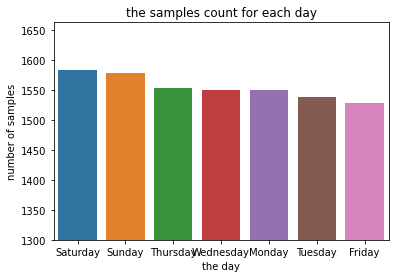

In [23]:
# plotting the number of samples in each day

# get the samples count
day_frequency = data['day'].value_counts().values

# define the labels 
day_classes = data['day'].value_counts().index

# creating the bar plot 
sns.barplot(day_classes,
            day_frequency,
            palette = sns.color_palette())

# set up the labels
plt.xlabel("the day") 
plt.ylabel("number of samples") 
plt.title("the samples count for each day")
plt.ylim(1300, None)
plt.show() 

<p class="alert alert-block alert-info">Saturday has the largest number of samples, Friday has the lowest number of smaples<p/>

### - part of the day

In [24]:
# get the unique values for the part of the day
data['part_of_day'].unique()

['Late Night', 'Early Morning', 'Morning', 'Noon', 'Eve', 'Night']
Categories (6, object): ['Late Night' < 'Early Morning' < 'Morning' < 'Noon' < 'Eve' < 'Night']

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


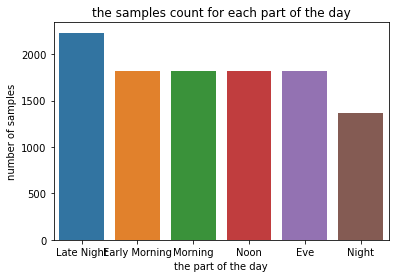

In [25]:
# plotting the number of samples in each part of the day

# get the samples count
part_of_day_frequency = data['part_of_day'].value_counts().values

# define the labels 
part_of_day_classes = data['part_of_day'].value_counts().index

# creating the bar plot 
sns.barplot(part_of_day_classes,
            part_of_day_frequency,
            palette = sns.color_palette())

# set up the labels
plt.xlabel("the part of the day") 
plt.ylabel("number of samples") 
plt.title("the samples count for each part of the day")
plt.show() 

<p class="alert alert-block alert-info">the late night part has largest number of smaples, the night has the lowest number of samples

### - season

In [26]:
# get the unique values in the season feature
data['season'].unique()

array(['spring', 'summer', 'fall', 'winter'], dtype=object)

In [27]:
# get the number of the samples for each season
data['season'].value_counts()

winter    2734
fall      2733
summer    2733
spring    2686
Name: season, dtype: int64

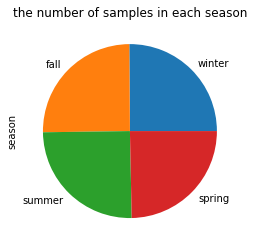

In [28]:
# pie chart to get better sense
data['season'].value_counts().plot.pie()

# set up the labels
plt.title("the number of samples in each season")
plt.show() 

<p class="alert alert-block alert-info">the samples have been collected through the four seasons. all seasons have almost the same number of samples<p/>

### - holiday

In [29]:
# get the number of the samples for each class
data['holiday'].value_counts()

0    10575
1      311
Name: holiday, dtype: int64

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


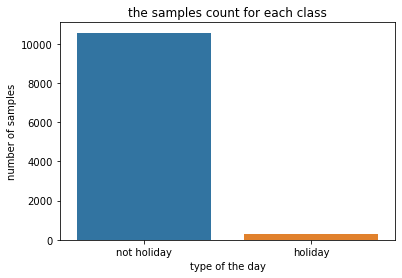

In [30]:
# plotting the number of samples in holidays and on other days

# get the samples count
holiday_frequency = data['holiday'].value_counts().values

# define the labels 
holiday_classes = ["not holiday","holiday"]

# creating the bar plot 
sns.barplot(holiday_classes,
            holiday_frequency,
            palette = sns.color_palette())

# set up the labels
plt.xlabel("type of the day") 
plt.ylabel("number of samples") 
plt.title("the samples count for each class") 
plt.show() 

<p class="alert alert-block alert-info">most samples have been collected in the days that are not holidays<p/>

### - workingday

In [31]:
# get the number of the samples for each class
data['workingday'].value_counts()

1    7412
0    3474
Name: workingday, dtype: int64

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


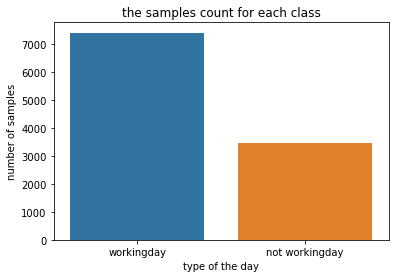

In [32]:
# plotting the number of samples in each part of the day

# get the samples count
workingday_frequency = data['workingday'].value_counts().values

# define the labels 
workingday_classes = ["workingday","not workingday"]

# creating the bar plot 
sns.barplot(workingday_classes,
            workingday_frequency,
            palette = sns.color_palette())

# set up the labels
plt.xlabel("type of the day") 
plt.ylabel("number of samples") 
plt.title("the samples count for each class") 
plt.show()

<p class="alert alert-block alert-info">most samples has been taken in the wokingdays<p/>

### - weather

In [33]:
# get the unique values
data['weather'].unique()

array([1, 2, 3, 4])

##### 1: Clear, Few clouds, Partly cloudy, Partly cloudy
##### 2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist
##### 3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds
##### 4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog 

In [34]:
# get the number of the samples for each weather
data['weather'].value_counts()

1    7192
2    2834
3     859
4       1
Name: weather, dtype: int64

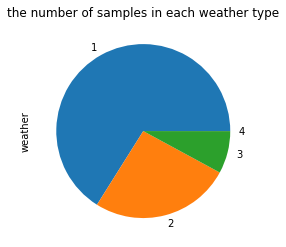

In [35]:
# pie chart to get better sense
data['weather'].value_counts().plot.pie()

# set up the labels
plt.title("the number of samples in each weather type")
plt.show() 

<p class="alert alert-block alert-info">the largest number of samples were taken when the weather was " Clear, Few clouds, Partly cloudy, Partly cloudy " and the smallest number of samples were taken when the weather was" Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog "

### - year

In [36]:
# get the number of samples for each year
data['year'].value_counts()

2012    5464
2011    5422
Name: year, dtype: int64

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


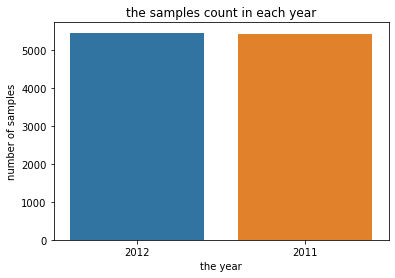

In [37]:
# plotting the number of samples in each year

# get the samples count
year_frequency = data['year'].value_counts().values

# define the labels 
year_classes = ["2012","2011"]

# creating the bar plot 
sns.barplot(year_classes,
            year_frequency,
            palette = sns.color_palette())

# set up the labels
plt.xlabel("the year") 
plt.ylabel("number of samples") 
plt.title("the samples count in each year")
plt.show() 

<p class="alert alert-block alert-info">the data has been taken in 2012 and 2011 as almost an equal number of samples<p/>

### - months

In [38]:
# get the unique values
data['month'].unique()

array(['January', 'February', 'March', 'April', 'May', 'June', 'July',
       'August', 'September', 'October', 'November', 'December'],
      dtype=object)

In [39]:
# get the number of samples for each month
data['month'].value_counts()

May          912
December     912
July         912
June         912
August       912
November     911
October      911
April        909
September    909
February     901
March        901
January      884
Name: month, dtype: int64

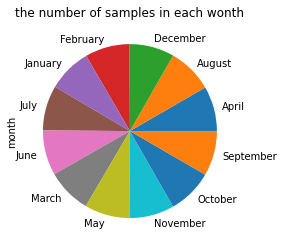

In [40]:
# pie chart to get a better sense
data['month'].value_counts().sort_index().plot.pie()

# set up the labels
plt.title("the number of samples in each wonth")
plt.show() 

<p class="alert alert-block alert-info">the data has been taken through all months in almost an equal number of samples in each month<p/>

### - hour

/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


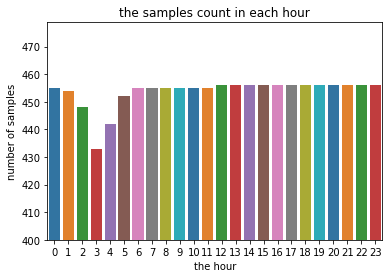

In [41]:
# plotting the number of samples in each hour

# get the samples count
hour_frequency = data['hour'].value_counts().values

# define the labels 
hour_classes = data['hour'].value_counts().index

# creating the bar plot 
sns.barplot(hour_classes,
            hour_frequency,
            palette = sns.color_palette())

# set up the labels
plt.xlabel("the hour") 
plt.ylabel("number of samples") 
plt.title("the samples count in each hour")
plt.ylim(400, None)
plt.show() 

<p class="alert alert-block alert-info">the number of samples is almost equal for all hours. but the hour 3:00 AM has the lowest number of samples<p/>

### numerical features : temp, atemp, humidity, windspeed, and count

### - temp

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


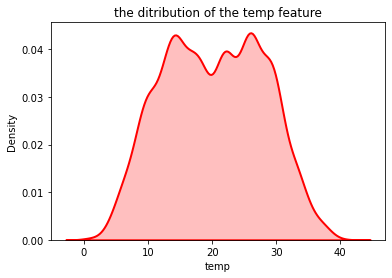

In [42]:
# check the distribution
sns.distplot(data.temp,
             hist = False,
             kde = True, 
             kde_kws = {'shade': True, 'linewidth': 2},  
             label = "temp", color ="red")

# set up the labels
plt.xlabel("temp") 
plt.title("the ditribution of the temp feature")
plt.show() 

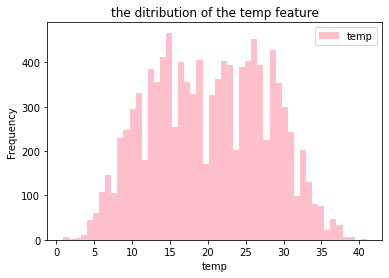

In [43]:
# check the distribution
data.temp.plot.hist(bins=50,
                    color="pink",
                    legend=True)

# set up the labels
plt.xlabel("temp") 
plt.title("the ditribution of the temp feature")
plt.show()

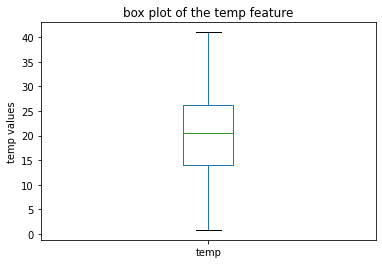

In [44]:
# box plot to check the outliers
data.temp.plot.box()

# set up the labels
plt.ylabel("temp values") 
plt.title("box plot of the temp feature")
plt.show()

<p class="alert alert-block alert-info">the distributin is kind of similler to the normal one. from the box plot it seems that there are no outliers<p/>

In [45]:
# find the min value
data.temp.min()

0.82

In [46]:
# find the max value
data.temp.max()

41.0

In [47]:
# find the mean
data.temp.mean()

20.230859819952173

In [48]:
# find the std
data.temp.std()

7.791589843987506

<p class="alert alert-block alert-info">the temperatures are from 0.82 to 41 celsius. the mean of the temperature is 20 celsius. the spread in average is about 8 pints from the mean<p/>

### - atemp

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


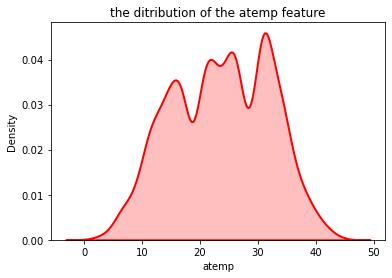

In [49]:
# check the distribution
sns.distplot(data.atemp,
             hist = False,
             kde = True, 
             kde_kws = {'shade': True, 'linewidth': 2},  
             label = "atemp", color ="red")

# set up the labels
plt.xlabel("atemp") 
plt.title("the ditribution of the atemp feature")
plt.show() 

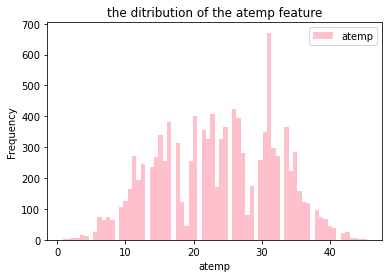

In [50]:
# check the distribution
data.atemp.plot.hist(bins=70,
                     color="pink",
                     legend=True)

# set up the labels
plt.xlabel("atemp") 
plt.title("the ditribution of the atemp feature")
plt.show()

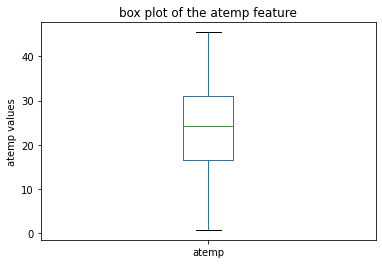

In [51]:
# box plot to check the outliers
data.atemp.plot.box()

# set up the labels
plt.ylabel("atemp values") 
plt.title("box plot of the atemp feature")
plt.show()

<p class="alert alert-block alert-info">the distributin is kind of similler to the normal one. from the box plot it seems that there are no outliers<p/>

In [52]:
# find the min value
data.atemp.min()

0.76

In [53]:
# find the max value
data.atemp.max()

45.455

In [54]:
# find the mean
data.atemp.mean()

23.65508405291192

In [55]:
# find the std
data.atemp.std()

8.474600626484888

<p class="alert alert-block alert-info">the temperatures are from 0.76 to 45.455 celsius.the mean of the "feels like" temperature is 24 Ccelsius. the spread in average is about 8 pints from the mean<p/>

### - humidity

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


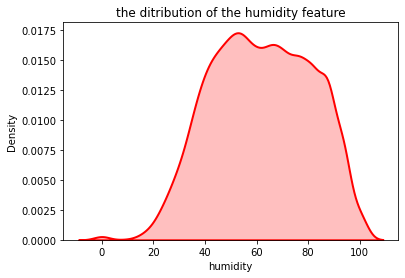

In [56]:
# check the distribution
sns.distplot(data.humidity,
             hist = False,
             kde = True, 
             kde_kws = {'shade': True, 'linewidth': 2},  
             label = "humidity", color ="red")

# set up the labels
plt.xlabel("humidity") 
plt.title("the ditribution of the humidity feature")
plt.show() 

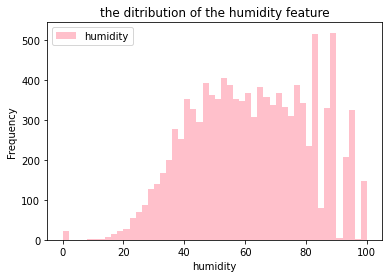

In [57]:
# check the distribution
data.humidity.plot.hist(bins=50,
                        color="pink",
                        legend=True)

# set up the labels
plt.xlabel("humidity") 
plt.title("the ditribution of the humidity feature")
plt.show() 

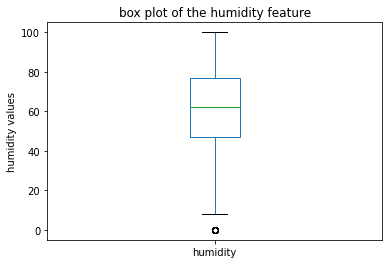

In [58]:
# box plot to check the outliers
data.humidity.plot.box()

# set up the labels
plt.ylabel("humidity values") 
plt.title("box plot of the humidity feature")
plt.show()

<p class="alert alert-block alert-info">the distributin is kind of similler to the normal one. there are outliers but we can keep them<p/>

In [59]:
# find the min value
data.humidity.min()

0

In [60]:
# find the max value
data.humidity.max()

100

In [61]:
# find the median
data.humidity.median()

62.0

In [62]:
# find the IQR
data.humidity.quantile(0.75)-data.humidity.quantile(0.25)

30.0

<p class="alert alert-block alert-info">the relative humidity values are from 0 to 100 .the median is 62. the spread in average is about 30 pints

###  - windspeed

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


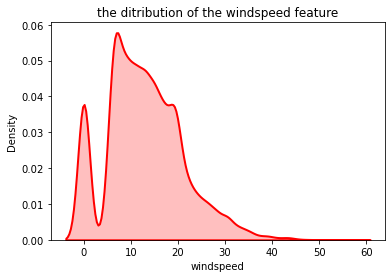

In [63]:
# check the distribution
sns.distplot(data.windspeed,
             hist = False,
             kde = True, 
             kde_kws = {'shade': True, 'linewidth': 2},  
             label = "windspeed", color ="red")

# set up the labels
plt.xlabel("windspeed") 
plt.title("the ditribution of the windspeed feature")
plt.show() 

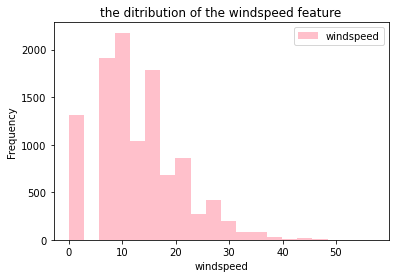

In [64]:
# check the distribution
data.windspeed.plot.hist(bins=20,
                         color="pink",
                         legend=True)

# set up the labels
plt.xlabel("windspeed") 
plt.title("the ditribution of the windspeed feature")
plt.show() 

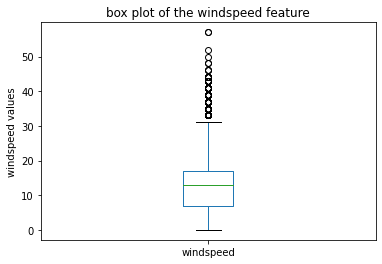

In [65]:
# box plot to check the outliers
data.windspeed.plot.box()

# set up the labels
plt.ylabel("windspeed values") 
plt.title("box plot of the windspeed feature")
plt.show()

<p class="alert alert-block alert-info">the distribution is skewed and there are outliers. we will deal with the skewness using binning

In [66]:
# find the min value
data.windspeed.min()

0.0

In [67]:
# find the max value
data.windspeed.max()

56.9969

In [68]:
# find the median
data.windspeed.median()

12.998

In [69]:
# find the IQR
data.windspeed.quantile(0.75)-data.windspeed.quantile(0.25)

9.996400000000001

<p class="alert alert-block alert-info">the wind speed values are from 0 to 57 .the median is 13. the spread in average is about 10 pints

### - count

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


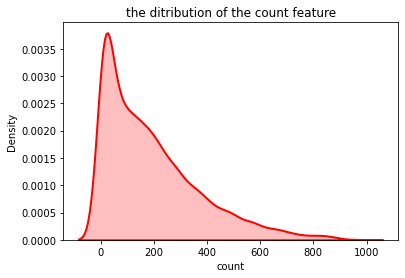

In [70]:
# check the distribution
sns.distplot(data['count'],
             hist = False,
             kde = True, 
             kde_kws = {'shade': True, 'linewidth': 2},  
             label = "count", color ="red")

# set up the labels
plt.xlabel("count") 
plt.title("the ditribution of the count feature")
plt.show() 

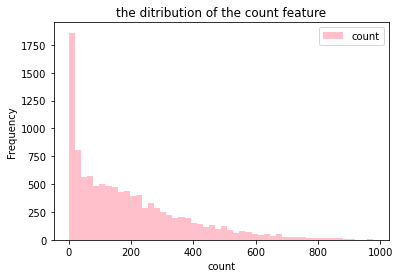

In [71]:
# check the distribution
data['count'].plot.hist(bins=50,
                        color="pink",
                        legend=True)

# set up the labels
plt.xlabel("count") 
plt.title("the ditribution of the count feature")
plt.show() 

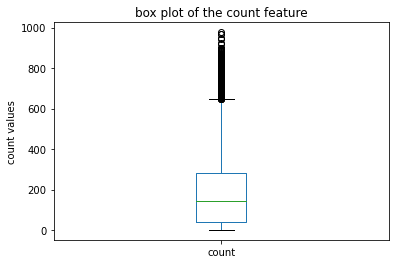

In [72]:
# box plot to check the outliers
data['count'].plot.box()

# set up the labels
plt.ylabel("count values") 
plt.title("box plot of the count feature")
plt.show()

<p class="alert alert-block alert-info">the distribution is skewed. it seems that there are outliers. we will use Box-Cox Transform to deal with skewness then see if the outliers will improved or not

In [73]:
# find the min value
data['count'].min()

1

In [74]:
# find the max value
data['count'].max()

977

In [75]:
# find the median
data['count'].median()

145.0

In [76]:
# find the IQR
data['count'].quantile(0.75) - data['count'].quantile(0.25)

242.0

<p class="alert alert-block alert-info">the rents count values are from 1 to 242 rent. the median is 145. the spread in average is 242 point

###  numerical features vs retnts count - Correlations

In [77]:
# slice the numerical features
numeric_features = data.loc[:,"temp":"count"]

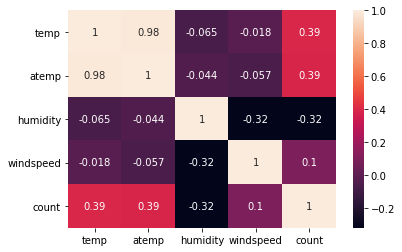

In [78]:
# get the correlation matrix 
correlation_mat = numeric_features.corr()

# plot the correlation matrix
sns.heatmap(correlation_mat,
            annot = True)
plt.show()

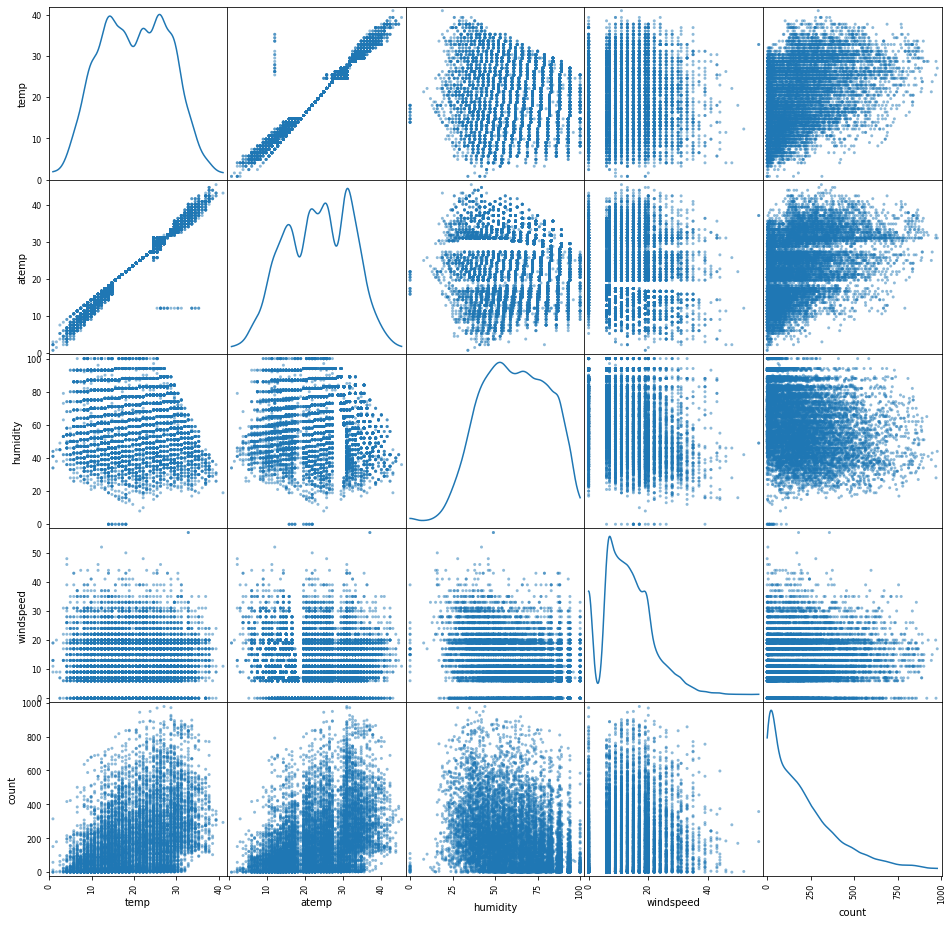

In [79]:
# scatter matrix to see the relationship between the count and the other features
pd.plotting.scatter_matrix(numeric_features,
                           figsize=(16, 16),
                           grid=False,
                           diagonal='kde')
plt.show()

<p class="alert alert-block alert-info">
    <strong>temp vs count : </strong> the correlation between the temp and the count is 0.39, which indicates that they’re weakly positively correlated. in other words, the more the temperature increases more the number of rents increases. also, from the scatter matrix the relationship between them is a weak positive relationship <br><br><br>
   <strong>atemp vs count : </strong> the correlation between the atemp and the count is 0.39, which indicates that they’re weakly positively correlated. in other words, the more the feel like temperature increases more the number of rents increases also, from the scatter matrix the relationship between them is a weak positive relationship <br><br><br>
  <strong>humidity vs count : </strong> the correlation between the humidity and the count is -0.32, which indicates that they’re weakly negatively correlated. in other words, the more the humidity increases more the number of rents decrease. also, from the scatter matrix the relationship between them is a weak negative relationship <br><br><br>
    <strong>windspeed vs count : </strong> the correlation between the wind speed and the count is 0.1, which indicates that they are basically not correlated. also, from the scatter matrix it seems that there is no relationship between them <br><br><br>
    
    
    


###  categorical features vs  rents count

### - yaer

In [80]:
# get the totoal number of rents for each year
years_count = data[['year','count']]\
                .groupby('year')\
                .agg('sum')\
                .reset_index()

In [81]:
years_count

,year,count
0,2011,781979
1,2012,1303497


/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


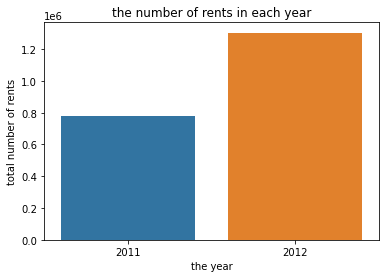

In [82]:
# bar plot between the year and the number of rents
sns.barplot(years_count.year,
            years_count['count'],
            palette=sns.color_palette())

# set up the labels
plt.xlabel("the year") 
plt.ylabel("total number of rents") 
plt.title("the number of rents in each year")
plt.show()

<p class="alert alert-block alert-info">2012 has higher number of rents which is 1303497, on the other hand the number of rents in 2011 is 781979


### - month

In [83]:
# find the total number of rents for each month
months_count = data[['year','month','count']]\
                .groupby(['year','month'])\
                .agg({'count':'sum'})\
                .reset_index()

In [84]:
months_count.head()

,year,month,count
0,2011,April,50517
1,2011,August,83296
2,2011,December,61183
3,2011,February,32844
4,2011,January,23552


In [85]:
# create a matrix that has the indexes as months and columns as year
pivot_months_count = months_count.pivot_table(index='month',
                                              columns='year',
                                              values='count',
                                              aggfunc='sum', 
                                              fill_value=0)

In [86]:
pivot_months_count

year,2011,2012
month,,
April,50517,116885
August,83296,130220
December,61183,98977
February,32844,66269
January,23552,56332
July,92848,121769
June,89776,130957
March,38735,94766
May,79713,120434


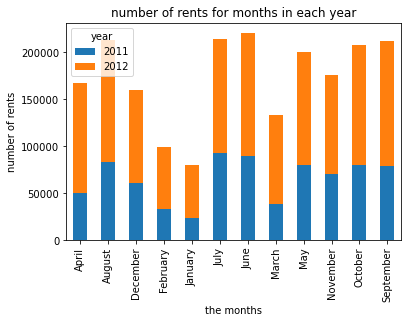

In [87]:
# bar plot to compare the number of rents in each month
pivot_months_count.plot.bar(stacked=True)

# set up the labels
plt.xlabel("the months") 
plt.ylabel("number of rents") 
plt.title("number of rents for months in each year") 
plt.show()

 <p class="alert alert-block alert-info">in 2012, September has the highest number of rents, January has the lowest number of rents. in 2011, July has the highest number of rents, January has the lowest number of rents. in the two years the behavior is almost the same


### - weekday

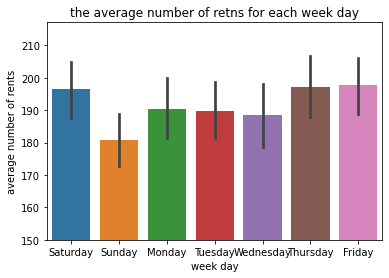

In [88]:
# bar plot to compare the average number of rents for each weekday
sns.barplot(data = data,
            x = 'day',
            y = 'count',
            palette=sns.color_palette())

# set up the labels
plt.xlabel("week day") 
plt.ylabel("average number of rents") 
plt.title("the average number of retns for each week day")
plt.ylim(150, None)
plt.show() 

 <p class="alert alert-block alert-info">Friday has the largest average number of rents, Sunday has the lowest average number of rents

### - hour

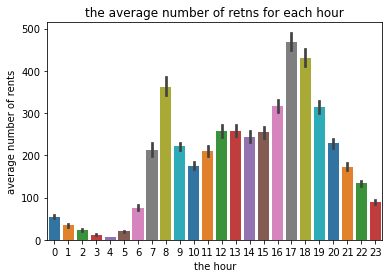

In [89]:
# bar plot to compare the average number of rents for each hour
sns.barplot(data = data,
            x = 'hour',
            y = 'count',
            palette=sns.color_palette())

# set up the labels
plt.xlabel("the hour") 
plt.ylabel("average number of rents") 
plt.title("the average number of retns for each hour")
plt.show() 

 <p class="alert alert-block alert-info"> the lowest average number of rents at 4:00 AM, the highest average number of rents at 5:00 PM

### - season

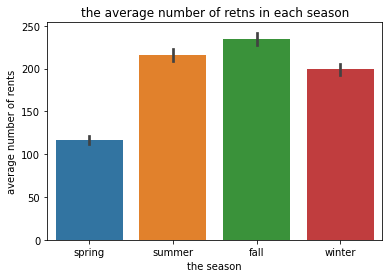

In [90]:
# bar plot to compare the average number of rents in each season
sns.barplot(data = data,
            x = 'season',
            y = 'count',
            palette=sns.color_palette())

# set up the labels
plt.xlabel("the season") 
plt.ylabel("average number of rents") 
plt.title("the average number of retns in each season")
plt.show() 

 <p class="alert alert-block alert-info"> the lowest average number of rents was in Spring, the highest average number of rents was in Fall

### - holiday

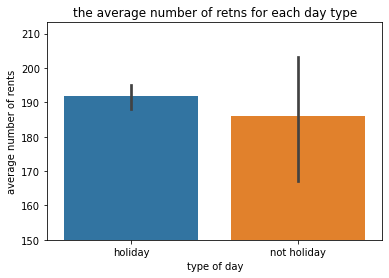

In [91]:
# bar plot to compare the average number of rents when the day is hoilday and not holiday
sns.barplot(data = data,
            x = 'holiday',
            y = 'count',
            palette=sns.color_palette())

# set up the labels
plt.xlabel("type of day") 
plt.ylabel("average number of rents") 
plt.title("the average number of retns for each day type")
plt.xticks([0,1], ['holiday','not holiday'],) 
plt.ylim(150, None)
plt.show() 

 <p class="alert alert-block alert-info"> the holidays have a larger average number of rents than other days

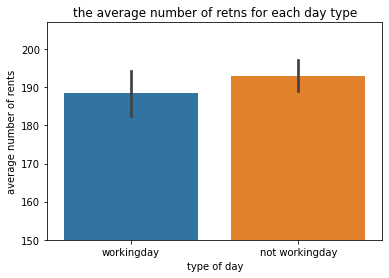

In [92]:
# bar plot to compare the average number of rents when the day is 
# workingday and not workingday
sns.barplot(data = data,
            x = 'workingday',
            y = 'count',
            palette=sns.color_palette())

# set up the labels
plt.xlabel("type of day") 
plt.ylabel("average number of rents") 
plt.title("the average number of retns for each day type")
plt.xticks([0,1], ['workingday','not workingday'],) 
plt.ylim(150, None)
plt.show() 

 <p class="alert alert-block alert-info"> the working days have a smaller average number of rents than other days

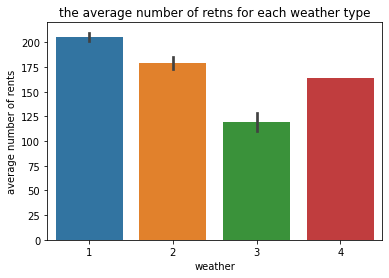

In [93]:
# bar plot to compare the average number of rents for each weather type
sns.barplot(data = data,
            x = 'weather',
            y = 'count',
            palette=sns.color_palette())

# set up the labels
plt.xlabel("weather") 
plt.ylabel("average number of rents") 
plt.title("the average number of retns for each weather type")
plt.show() 

##### 1: Clear, Few clouds, Partly cloudy, Partly cloudy
##### 2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist
##### 3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds
##### 4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog 

 <p class="alert alert-block alert-info"> the weather "Clear, Few clouds, Partly cloudy, Partly cloudy" has the largest average number of rents. on the other hand, the weather " Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds" has the lowest average number of rents

### - part of the day

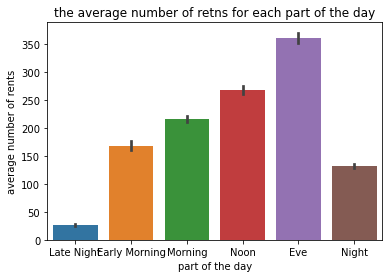

In [94]:
# bar plot to compare the average number of rents for each part of the day
sns.barplot(data = data,
            x = 'part_of_day',
            y = 'count',
            palette=sns.color_palette())

# set up the labels
plt.xlabel("part of the day") 
plt.ylabel("average number of rents") 
plt.title("the average number of retns for each part of the day")
plt.show() 

 <p class="alert alert-block alert-info"> the evening has the highest average number of rents. the late night has the lowest average number of rents

# `feature engineering`

<p class="alert alert-block alert-success">in this section, we deal with skewness in features, encode categorical features, and normalize numerical features

### - dealing with the skewness in the count feature using Box-Cox transform

In [95]:
# get the optimal lambda
l, opt_lambda = stats.boxcox(np.array(data['count']))

In [96]:
# transform the feature 
data['count'] = stats.boxcox(data['count'],lmbda=opt_lambda)

/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


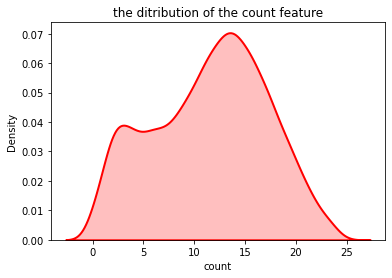

In [97]:
# check the distribution after tranforming it
sns.distplot(data['count'],
             hist = False,
             kde = True, 
             kde_kws = {'shade': True, 'linewidth': 2},  
             label = "count", color ="red")

# set up the labels
plt.xlabel("count") 
plt.title("the ditribution of the count feature")
plt.show() 

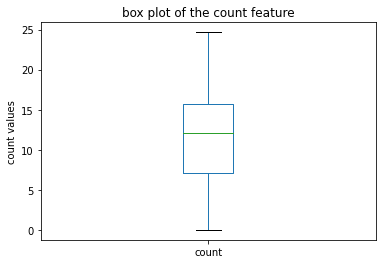

In [98]:
# check the outliers after tranforming it
data['count'].plot.box()

# set up the labels
plt.ylabel("count values") 
plt.title("box plot of the count feature")
plt.show()

<p class="alert alert-block alert-info">we can see that after the transformation the distribution has became almost normal. also now there are no outliers

### - deal with the skewness in the windspeed feature using adaptive binning

In [99]:
# define the labels they will be the feature classes
quantile_labels = ['windspeed-0-25Q', 'windspeed-25-50Q',
                   'windspeed-50-75Q', 'windspeed-75-100Q']

# the quantiles values
quantile_list = [0, 0.25, 0.5, 0.75, 1.0]

# discretize based on the quartiles
data['windspeed'] = pd.qcut(data.windspeed,
                            q = quantile_list,       
                            labels = quantile_labels)

In [100]:
data.head()

,year,month,day,hour,part_of_day,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count
0,2011,January,Saturday,0,Late Night,spring,0,0,1,9.84,14.395,81,windspeed-0-25Q,4.433145
1,2011,January,Saturday,1,Late Night,spring,0,0,1,9.02,13.635,80,windspeed-0-25Q,6.982674
2,2011,January,Saturday,2,Late Night,spring,0,0,1,9.02,13.635,80,windspeed-0-25Q,6.292274
3,2011,January,Saturday,3,Late Night,spring,0,0,1,9.84,14.395,75,windspeed-0-25Q,3.950910
4,2011,January,Saturday,4,Late Night,spring,0,0,1,9.84,14.395,75,windspeed-0-25Q,0.000000


<p class="alert alert-block alert-info">we can see that after the transformation, the feature became a categorical feature

### - encoding categrical features using get dummies

### season

In [101]:
# encode the feature
season = pd.get_dummies(data.season)

# add them to the data this dataframe will be the one we work with it. it has
# all features encoded
data_encoded = pd.concat([data,season],axis=1)

# drop the original column
data_encoded = data_encoded.drop(["season"],axis=1)

In [102]:
data_encoded.head()

,year,month,day,hour,part_of_day,holiday,workingday,weather,temp,atemp,humidity,windspeed,count,fall,spring,summer,winter
0,2011,January,Saturday,0,Late Night,0,0,1,9.84,14.395,81,windspeed-0-25Q,4.433145,0,1,0,0
1,2011,January,Saturday,1,Late Night,0,0,1,9.02,13.635,80,windspeed-0-25Q,6.982674,0,1,0,0
2,2011,January,Saturday,2,Late Night,0,0,1,9.02,13.635,80,windspeed-0-25Q,6.292274,0,1,0,0
3,2011,January,Saturday,3,Late Night,0,0,1,9.84,14.395,75,windspeed-0-25Q,3.950910,0,1,0,0
4,2011,January,Saturday,4,Late Night,0,0,1,9.84,14.395,75,windspeed-0-25Q,0.000000,0,1,0,0


### weather

In [103]:
# encode the feature
weather = pd.get_dummies(data.weather,
                         prefix="weather")

# add them to the data
data_encoded = pd.concat([data_encoded,weather],axis=1)

# drop the original column
data_encoded  = data_encoded.drop(["weather"],axis=1)

In [104]:
data_encoded.head()

,year,month,day,hour,part_of_day,holiday,workingday,temp,atemp,humidity,windspeed,count,fall,spring,summer,winter,weather_1,weather_2,weather_3,weather_4
0,2011,January,Saturday,0,Late Night,0,0,9.84,14.395,81,windspeed-0-25Q,4.433145,0,1,0,0,1,0,0,0
1,2011,January,Saturday,1,Late Night,0,0,9.02,13.635,80,windspeed-0-25Q,6.982674,0,1,0,0,1,0,0,0
2,2011,January,Saturday,2,Late Night,0,0,9.02,13.635,80,windspeed-0-25Q,6.292274,0,1,0,0,1,0,0,0
3,2011,January,Saturday,3,Late Night,0,0,9.84,14.395,75,windspeed-0-25Q,3.950910,0,1,0,0,1,0,0,0
4,2011,January,Saturday,4,Late Night,0,0,9.84,14.395,75,windspeed-0-25Q,0.000000,0,1,0,0,1,0,0,0


### windspeed

In [105]:
# encode the feature
windspeed = pd.get_dummies(data.windspeed)

# add them to the data
data_encoded = pd.concat([data_encoded,windspeed],axis=1)

# drop the original column
data_encoded  = data_encoded.drop(["windspeed"],axis=1)

In [106]:
data_encoded.head()

,year,month,day,hour,part_of_day,holiday,workingday,temp,atemp,humidity,...,summer,winter,weather_1,weather_2,weather_3,weather_4,windspeed-0-25Q,windspeed-25-50Q,windspeed-50-75Q,windspeed-75-100Q
0,2011,January,Saturday,0,Late Night,0,0,9.84,14.395,81,...,0,0,1,0,0,0,1,0,0,0
1,2011,January,Saturday,1,Late Night,0,0,9.02,13.635,80,...,0,0,1,0,0,0,1,0,0,0
2,2011,January,Saturday,2,Late Night,0,0,9.02,13.635,80,...,0,0,1,0,0,0,1,0,0,0
3,2011,January,Saturday,3,Late Night,0,0,9.84,14.395,75,...,0,0,1,0,0,0,1,0,0,0
4,2011,January,Saturday,4,Late Night,0,0,9.84,14.395,75,...,0,0,1,0,0,0,1,0,0,0


### date related features

#### -- year

In [107]:
# since there is no meaning of taking the year as number, 2011 and 2012 actually don't have
# the meaning of its numeric values so we encode them
data_encoded['year'] = data_encoded['year'].map({2011:0, 2012:1})

#### -- hour

In [108]:
# encode the hour
hour = pd.get_dummies(data.hour)

# add them to the data
data_encoded = pd.concat([data_encoded,hour],axis=1)

# drop the original columns
data_encoded  = data_encoded.drop(['hour'],axis=1)

#### -- weekday, part of the day, moth

In [109]:
# get the names of the date related features
date_features = ['day','part_of_day','month']

# encode the features
features_encoded = pd.get_dummies(data[date_features])

# add them to the data
data_encoded = pd.concat([data_encoded,features_encoded],axis=1)

# drop the original columns
data_encoded  = data_encoded.drop(date_features,axis=1)

In [110]:
data_encoded.head()

,year,holiday,workingday,temp,atemp,humidity,count,fall,spring,summer,...,month_December,month_February,month_January,month_July,month_June,month_March,month_May,month_November,month_October,month_September
0,0,0,0,9.84,14.395,81,4.433145,0,1,0,...,0,0,1,0,0,0,0,0,0,0
1,0,0,0,9.02,13.635,80,6.982674,0,1,0,...,0,0,1,0,0,0,0,0,0,0
2,0,0,0,9.02,13.635,80,6.292274,0,1,0,...,0,0,1,0,0,0,0,0,0,0
3,0,0,0,9.84,14.395,75,3.950910,0,1,0,...,0,0,1,0,0,0,0,0,0,0
4,0,0,0,9.84,14.395,75,0.000000,0,1,0,...,0,0,1,0,0,0,0,0,0,0


In [111]:
# check if i still have categorial features
(data_encoded.dtypes == object).sum()

0

### -  feature normalization

In [112]:
# slice the numeric features
numeric_fearures = data_encoded.loc[:,"temp":"count"]

In [113]:
# fit scaler on data
norm = StandardScaler().fit(numeric_fearures)

# transform data
numiric_fearures_norm = norm.transform(numeric_fearures)

# rename columns
data_normalized = pd.DataFrame(numiric_fearures_norm).\
rename(columns={0: "temp", 1: "atemp", 2:"humidity", 3:"count"}) 

In [114]:
data_normalized.head()

,temp,atemp,humidity,count
0,-1.333661,-1.092737,0.993213,-1.255010
1,-1.438907,-1.182421,0.941249,-0.801417
2,-1.438907,-1.182421,0.941249,-0.924248
3,-1.333661,-1.092737,0.681430,-1.340805
4,-1.333661,-1.092737,0.681430,-2.043720


In [115]:
# add the normalized features to the dataframe
data_encoded.loc[:,"temp":"count"] = data_normalized

<AxesSubplot:>

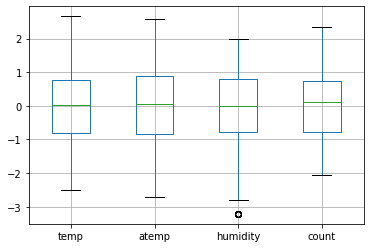

In [116]:
# box plot for the normlized data
data_normalized.boxplot()

<p class="alert alert-block alert-info">we can see now the numeric features in one scale

# `try different machine learning models`

<p class="alert alert-block alert-success">in this section, we use different machine learning algorithms to train models and predint the number of rents

# ` linear regression`

In [117]:
# slice the target variable and the other features
target = data_encoded['count']
features = data_encoded.drop(['count'],axis=1)

In [118]:
features.head()

,year,holiday,workingday,temp,atemp,humidity,fall,spring,summer,winter,...,month_December,month_February,month_January,month_July,month_June,month_March,month_May,month_November,month_October,month_September
0,0,0,0,-1.333661,-1.092737,0.993213,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0
1,0,0,0,-1.438907,-1.182421,0.941249,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0
2,0,0,0,-1.438907,-1.182421,0.941249,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0
3,0,0,0,-1.333661,-1.092737,0.681430,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0
4,0,0,0,-1.333661,-1.092737,0.681430,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0


In [119]:
# splitting the data into train and test datasets
x_train, x_test, y_train, y_test = train_test_split(features, 
                                                    target, 
                                                    test_size=0.3)

In [120]:
# define a linear regression object
linear_regression = LinearRegression()

# fit the linear regression model
linear_regression.fit(x_train, y_train)

LinearRegression()

In [121]:
# check the acurecy - coefficient of determination (R^2) of the prediction
linear_regression.score(x_test,y_test)

0.8126008817729421

<p class="alert alert-block alert-info">the accurecy is 82%. we will try to generate polynomial features and see if the acurecy will improve or not

In [122]:
# define the properties of the generated features
poly_features = PolynomialFeatures(degree=2,
                                   interaction_only=False,  
                                   include_bias=False)

In [123]:
# generate the features using the temp and the humidity features
poly_features_res = poly_features.fit_transform(data_encoded[["temp","humidity"]])

In [124]:
# add the features to a new dataframe
poly_df = pd.DataFrame(poly_features_res)
data_with_poly = pd.concat([data_encoded,poly_df], axis=1)

In [125]:
data_with_poly.head()

,year,holiday,workingday,temp,atemp,humidity,count,fall,spring,summer,...,month_March,month_May,month_November,month_October,month_September,0,1,2,3,4
0,0,0,0,-1.333661,-1.092737,0.993213,-1.255010,0,1,0,...,0,0,0,0,0,-1.333661,0.993213,1.778651,-1.324609,0.986472
1,0,0,0,-1.438907,-1.182421,0.941249,-0.801417,0,1,0,...,0,0,0,0,0,-1.438907,0.941249,2.070454,-1.354370,0.885950
2,0,0,0,-1.438907,-1.182421,0.941249,-0.924248,0,1,0,...,0,0,0,0,0,-1.438907,0.941249,2.070454,-1.354370,0.885950
3,0,0,0,-1.333661,-1.092737,0.681430,-1.340805,0,1,0,...,0,0,0,0,0,-1.333661,0.681430,1.778651,-0.908796,0.464347
4,0,0,0,-1.333661,-1.092737,0.681430,-2.043720,0,1,0,...,0,0,0,0,0,-1.333661,0.681430,1.778651,-0.908796,0.464347


In [126]:
# slice the target variable and the other features
target_poly = data_with_poly['count']
features_poly = data_with_poly.drop(['count'],axis=1)

In [127]:
# splitting the data into train and test
x_train_poly, x_test_poly, y_train_poly, y_test_poly = train_test_split(features_poly, 
                                                       target_poly, 
                                                       test_size=0.3)

In [128]:
# fit the linear regression model after adding the poly features
linear_regression_poly = LinearRegression().fit(x_train_poly, y_train_poly)

In [129]:
# check the accurecy - coefficient of determination (R^2) of the prediction
linear_regression_poly.score(x_test_poly,y_test_poly)

-5223085261242.499

<p class="alert alert-block alert-info">the accuracy now is 82.5%. the accuracy is almost the same. there is no effect happened when using polynomial features

# `k-nearest neighbors`

###  chooseing K using elbow method

In [130]:
def find_error_rate_knn(x_train,y_train,x_test,y_test):
    """ find the mean squared error when using each value of K

    Args:
        x_train (list): the features for training
        y_train (list): the target variable for training
        x_test (list): the features for testing
        y_test (list): the target variable for testing

    Returns:
        dict: each value of K and its error value
    """
    
    # define a list to store the error rates on each K
    error_rate = {}

    # take a range of K from 1 to 30
    for k in range(1,30):

        # set the number of neighbors
        knn = KNeighborsRegressor(n_neighbors=k)

        # fit the model
        knn.fit(x_train, y_train)

        # find the mean squared error
        mse = math.sqrt(mean_squared_error(y_test, knn.predict(x_test)))
        
        # add the error rate, which is the mean squared error
        error_rate[k] = mse
    
    # return the results
    return error_rate

In [131]:
# find the error rates
errors_rates_knn = find_error_rate_knn(x_train, y_train, x_test, y_test)

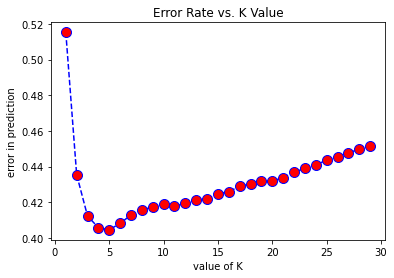

In [132]:
# plot the error rates to get a better sense
plt.plot(list(errors_rates_knn.keys()),
         list(errors_rates_knn.values()),
         color='blue',
         linestyle='dashed',
         marker='o',
         markerfacecolor='red',
         markersize=10)

# set up the labels
plt.title('Error Rate vs. K Value')
plt.xlabel("value of K")
plt.ylabel("error in prediction") 
plt.show() 

<p class="alert alert-block alert-info">from the plot we can see that when k is about 5 the error rate is the smallest 

In [133]:
# sort the k vales based on the error rate
sorted_errors_rates_knn = sorted(errors_rates_knn.items(), key=operator.itemgetter(1))

In [134]:
sorted_errors_rates_knn[:5]

[(5, 0.40450996530174793),
 (4, 0.4057737980891983),
 (6, 0.40826961155500713),
 (3, 0.4123007023420153),
 (7, 0.4128271270941832)]

In [135]:
# get the optimal k
opt_k = sorted_errors_rates_knn[0][0]

In [136]:
opt_k

5

### - fit the model

In [137]:
# set the number of neighbors
knn_model = KNeighborsRegressor(n_neighbors = opt_k)

# fit the model
knn_model.fit(x_train, y_train)

KNeighborsRegressor()

In [138]:
# check the score - coefficient of determination (R^2) of the prediction
knn_model.score(x_test, y_test)

0.837614481813128

<p class="alert alert-block alert-info">the accurecy is 84%

# `Decision Tree`

In [139]:
# create a copy from the original dataset
decision_tree_data = data.copy()

In [140]:
decision_tree_data.head()

,year,month,day,hour,part_of_day,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count
0,2011,January,Saturday,0,Late Night,spring,0,0,1,9.84,14.395,81,windspeed-0-25Q,4.433145
1,2011,January,Saturday,1,Late Night,spring,0,0,1,9.02,13.635,80,windspeed-0-25Q,6.982674
2,2011,January,Saturday,2,Late Night,spring,0,0,1,9.02,13.635,80,windspeed-0-25Q,6.292274
3,2011,January,Saturday,3,Late Night,spring,0,0,1,9.84,14.395,75,windspeed-0-25Q,3.950910
4,2011,January,Saturday,4,Late Night,spring,0,0,1,9.84,14.395,75,windspeed-0-25Q,0.000000


In [142]:
# define the categorical columns names to encode them
columns_to_encode = ['year', 'season', 'windspeed', 'month', 'part_of_day', 'day']

# create an encoder object
label_encoder = preprocessing.LabelEncoder()

# do label encoding for the columns
for column in columns_to_encode:
    
    # replace the origin column with the encoded one
    decision_tree_data[column] = label_encoder.fit_transform(decision_tree_data[column])


In [143]:
decision_tree_data.head()

,year,month,day,hour,part_of_day,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count
0,0,4,2,0,2,1,0,0,1,9.84,14.395,81,0,4.433145
1,0,4,2,1,2,1,0,0,1,9.02,13.635,80,0,6.982674
2,0,4,2,2,2,1,0,0,1,9.02,13.635,80,0,6.292274
3,0,4,2,3,2,1,0,0,1,9.84,14.395,75,0,3.950910
4,0,4,2,4,2,1,0,0,1,9.84,14.395,75,0,0.000000


In [144]:
# slice the target variable and the other features
target_tree = decision_tree_data['count']
features_tree = decision_tree_data.drop(['count'],axis=1)

In [145]:
# split the dataset into training and testing datasets
tree_x_train, tree_x_test, tree_y_train, tree_y_test = train_test_split(features_tree,
                                                                        target_tree,
                                                                        test_size=0.3)

In [146]:
# define a decision tree object
regression_tree = tree.DecisionTreeRegressor()

# fit the model
regression_tree = regression_tree.fit(tree_x_train, tree_y_train)

In [147]:
# check the score - coefficient of determination (R^2) of the prediction
regression_tree.score(tree_x_test, tree_y_test)

0.9085616059648997

<p class="alert alert-block alert-info">the accurecy is 90%

### - feature importances

In [148]:
# define the feature importance dataframe
feature_importances = pd.DataFrame(columns=['feature','feature_importance'])

In [149]:
# add the features names
feature_importances.feature = tree_x_train.columns

In [150]:
# add the features importances values
feature_importances.feature_importance = regression_tree.feature_importances_ * 100

In [151]:
# display the sorted features importance values with each feature name
feature_importances.sort_values(by = 'feature_importance', ascending = False)

,feature,feature_importance
3,hour,66.424523
9,temp,7.248482
7,workingday,5.704011
4,part_of_day,5.579640
0,year,5.079093
11,humidity,2.433764
5,season,2.184514
8,weather,1.500814
10,atemp,1.377325
2,day,0.974476


<p class="alert alert-block alert-info">the prediced process is mostly affected by the hour feature

### - visualize the tree

In [152]:
# I did this to solve the problem of importing the graphviz library
os.environ["PATH"] += os.pathsep +'/opt/anaconda3/bin'

In [155]:
#  generates a GraphViz representation of the decision tree
dot_data = tree.export_graphviz(
    regression_tree,
    out_file=None, 
    feature_names=tree_x_train.columns,  
    class_names="count",  
    filled=True,
    rounded=True,  
    special_characters=True)

# create a graphviz object using the dot data
graph = graphviz.Source(dot_data)  

In [156]:
# print the tree graph
graph

# `ridge regression`

### - find the optimal alpha

In [3595]:
def find_error_rate_ridge(x_train,y_train,x_test,y_test):
    """ find the mean squared error when using each alpha
    Args:
        x_train (list): the features for training
        y_train (list): the target variable for training
        x_test (list): the features for testing
        y_test (list): the target variable for testing

    Returns:
        dict: each value of alpha and its error value
    """
    
    # define a list to store the error rates on each alpha. 
    error_rate = {}

    # take a range of alphas values
    for alpha in [0.00001,0.00005,0.0001,0.0005,0.001,0.005,0.01,0.05,0.1]:

        # create a ridge object and set the value of alpha
        ridge = Ridge(alpha = alpha)

        # fit the model
        ridge.fit(x_train, y_train)
        
        # find the mean squared error
        mse = math.sqrt(mean_squared_error(y_test, ridge.predict(x_test)))
        
        # add the error rate, which is the mean squared error
        error_rate[alpha] = mse
        
    # return the results
    return error_rate

In [3596]:
# find the errors rates
ridge_errors_rates = find_error_rate_ridge(x_train,y_train,x_test,y_test)

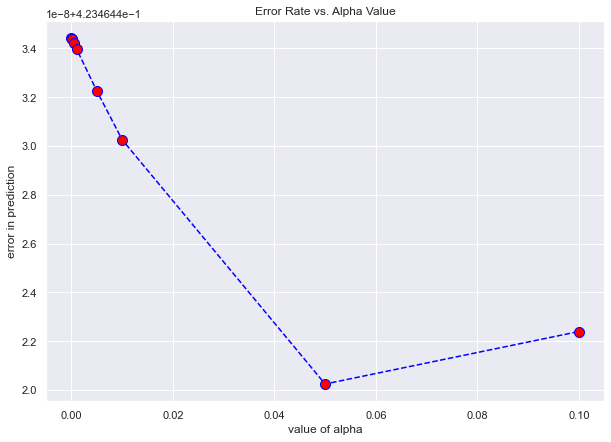

In [3597]:
# plot the error rates to get a better sense
plt.plot(list(ridge_errors_rates.keys()),
         list(ridge_errors_rates.values()),
         color='blue',
         linestyle='dashed',
         marker='o',
         markerfacecolor='red',
         markersize=10)

# set up the labels
plt.title('Error Rate vs. Alpha Value')
plt.xlabel("value of alpha")
plt.ylabel("error in prediction") 
plt.show() 

<p class="alert alert-block alert-info"> from the plot we can see that the lowest error when the value of alpha is 0.05

In [3598]:
# sort the alpha vales based on the error rate
sorted_errors_rates_ridge = sorted(ridge_errors_rates.items(), key=operator.itemgetter(1))

In [3599]:
sorted_errors_rates_ridge[:5]

[(0.05, 0.42346442024101677),
 (0.1, 0.4234644223926264),
 (0.01, 0.4234644302576286),
 (0.005, 0.4234644322601813),
 (0.001, 0.42346443398379496)]

In [3569]:
# get the optimal alpha
alpha = sorted_errors_rates_ridge[0][0]

In [3572]:
alpha

0.05

In [3570]:
# define the ridge object and set the value of alpha
ridge = Ridge(alpha = alpha)

# fit the model
ridge.fit(x_train, y_train)

Ridge(alpha=0.05)

In [3571]:
# check the score - coefficient of determination (R^2) of the prediction
ridge.score(x_test, y_test)

0.8210633086950421

<p class="alert alert-block alert-info">the acurecy is 82% using 0.05 as the value of alpha

# `models prediction vs ground truth`

<p class="alert alert-block alert-success">in this section we compare the results of the models with the ground truth data.

### - retrain the decision tree

In [3573]:
# in the decision tree section we used different encoded way 
# ( for visualization perposes ) so the data is deferent. 
# here we train a decision tree using the same encoded data 
# we used on training the other models.

# define a decision tree object
decision_tree = tree.DecisionTreeRegressor()

# fit the model using the same encoded data we used on fitting the other models
decision_tree = decision_tree.fit(x_train, y_train)

### - collect the results from each model

In [3575]:
# define the models names with its model object
models_names = {'ground_truth' : None,
                'linear_model' : linear_regression,
                'knn' : knn_model,
                'ridge' : ridge,
                'decision_tree' : decision_tree}

# define a dataframe to add the results from each model
result_df = pd.DataFrame(columns = models_names.keys())

# add the ground truth to the dataframe
result_df['ground_truth'] = y_test

# loop over the models 
for model in list(models_names.keys())[1:]:
    
    # predict using the model and add the results to the dataframe
    result_df[model] = models_names[model].predict(x_test)


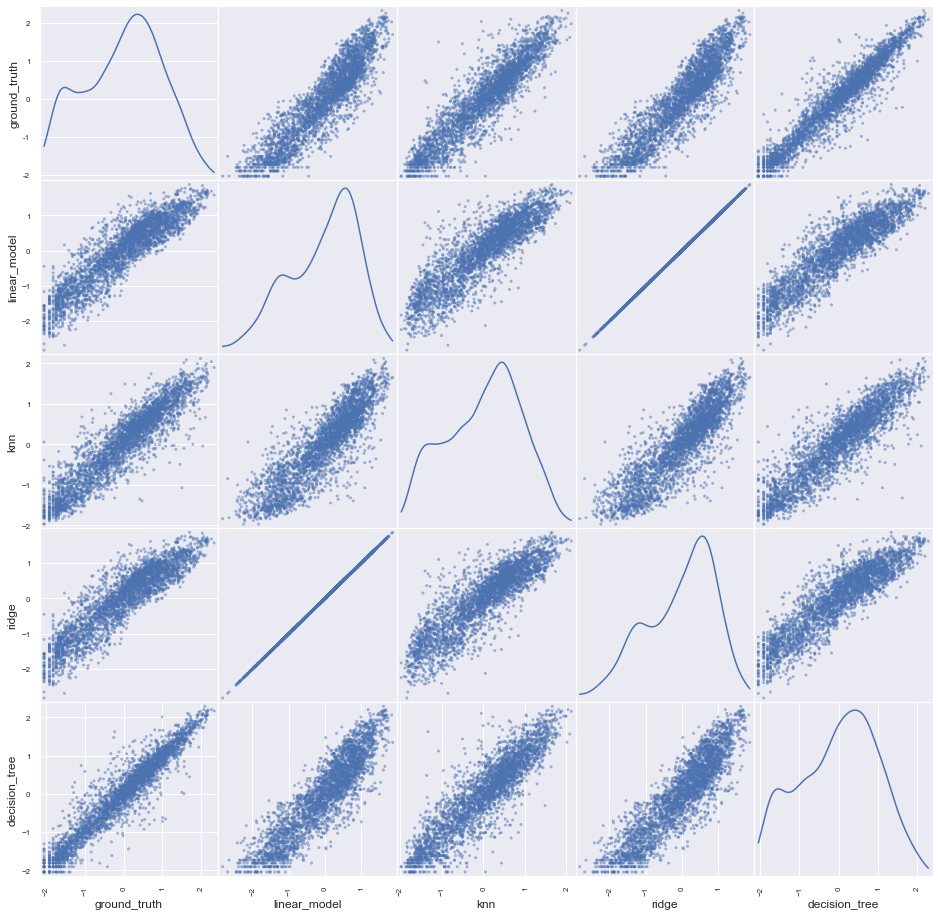

In [3576]:
# scatter matrix to see the relationship between the ground truth and the predicted value
pd.plotting.scatter_matrix(result_df,
                           figsize=(16, 16),
                           grid=False,
                           diagonal='kde')
plt.show()

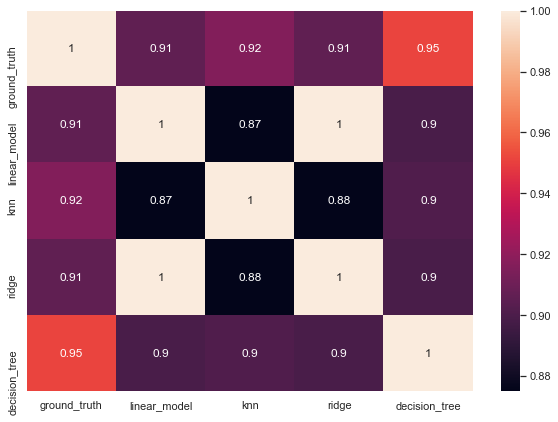

In [3577]:
# get the correlation matrix 
correlation_matrix_models = result_df.corr()

# plot the correlation matrix
sns.heatmap(correlation_matrix_models,
            annot = True)
plt.show()

<p class="alert alert-block alert-info">
    <strong>linear model : </strong> the correlation between the linear model results and the ground truth is 0.91 , which indicates that they’re strongly positively correlated.  also, from the scatter matrix the relationship between them is not exactly linear there some abvouse errors <br><br><br>
  <strong>ridge : </strong> the correlation between the ridge results and the ground truth is 0.91 , which indicates that they’re strongly positively correlated.  also, from the scatter matrix the relationship between them is not exactly linear there some abvouse errors. the behavior is almost the same as the linear model <br><br><br>
 <strong>knn : </strong> the correlation between the knn results and the ground truth is 0.92 , which indicates that they’re strongly positively correlated.  also, from the scatter matrix the relationship between them is better than the ridge and the linear model <br><br><br>
   <strong>decision tree : </strong> the correlation between the decision tree results and the ground truth is 0.95, which indicates that they’re strongly positively correlated.  also, from the scatter matrix the relationship between them is the best comparing to other models <br>
    
  